# Import and clean data

In [15]:
from pandas import read_csv
# Load the dataset
data = read_csv("housing.csv")
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


Dataset loaded successfully with shape: (20640, 10)
Missing values per column:
total_bedrooms    207
dtype: int64


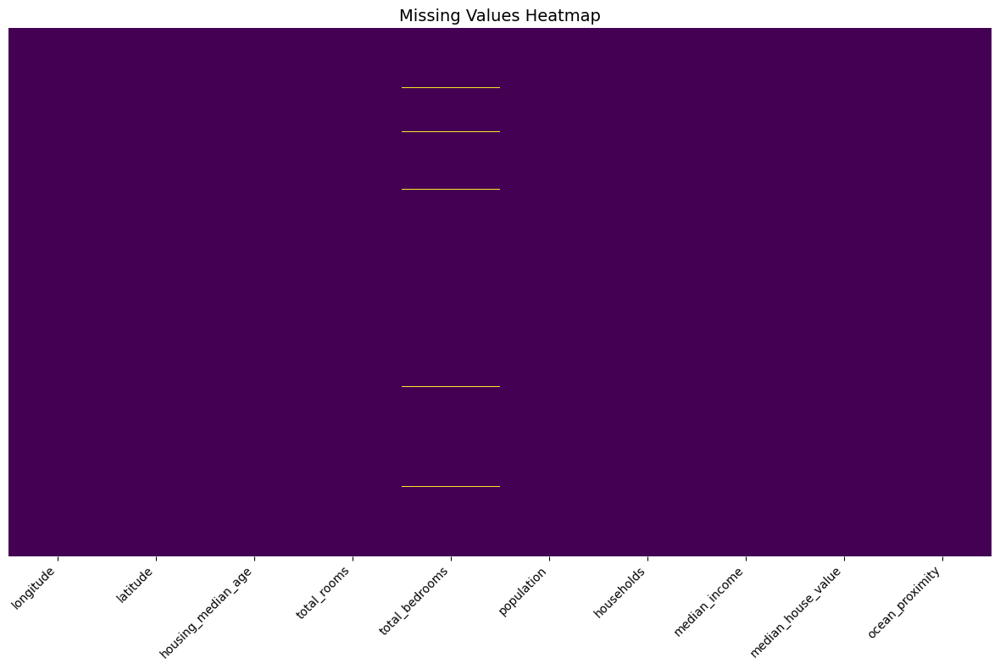

Dropped rows with missing values. Shape changed from (20640, 10) to (20433, 10).
Normalization complete for columns: ['housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']
Categorical variables transformed into numeric (one-hot encoded) variables.
Processed dataset saved to 'processed_housing.csv'.
   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.23     37.88            0.982163    -0.803813       -0.970325   
1    -122.22     37.86           -0.606210     2.042130        1.348276   
2    -122.24     37.85            1.855769    -0.535189       -0.825561   
3    -122.25     37.85            1.855769    -0.623510       -0.718768   
4    -122.25     37.85            1.855769    -0.461970       -0.611974   

   population  households  median_income  median_house_value  \
0   -0.973320   -0.976833       2.345163            452600.0   
1    0.861339    1.670373       2.332632            358500.0   
2   -0.8197

In [14]:
from data import DataProcessor

# Initialize the processor with the file path
processor = DataProcessor("housing.csv")

# Load the data
processor.load_data()

# Check for missing values
processor.check_missing_values()

processor.plot_missing_values()

# Drop rows with missing values
processor.drop_missing_values()

# Normalize numeric columns
numeric_columns = ["housing_median_age", "total_rooms", "total_bedrooms", "population", "households", "median_income"]
processor.normalize_columns(numeric_columns)

# Transform categorical variables
processor.transform_categorical_to_numeric()

# Save the processed dataset
processor.save_processed_data("processed_housing.csv")

# Get the processed data for further analysis
processed_data = processor.get_data()
print(processed_data.head())


# Exploratory Data Analysis


Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB
None

First five rows of the dataset:
   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
0    -122.23     37.88                41.0        880.0           129.0   
1    -122.22     37.86                21.0

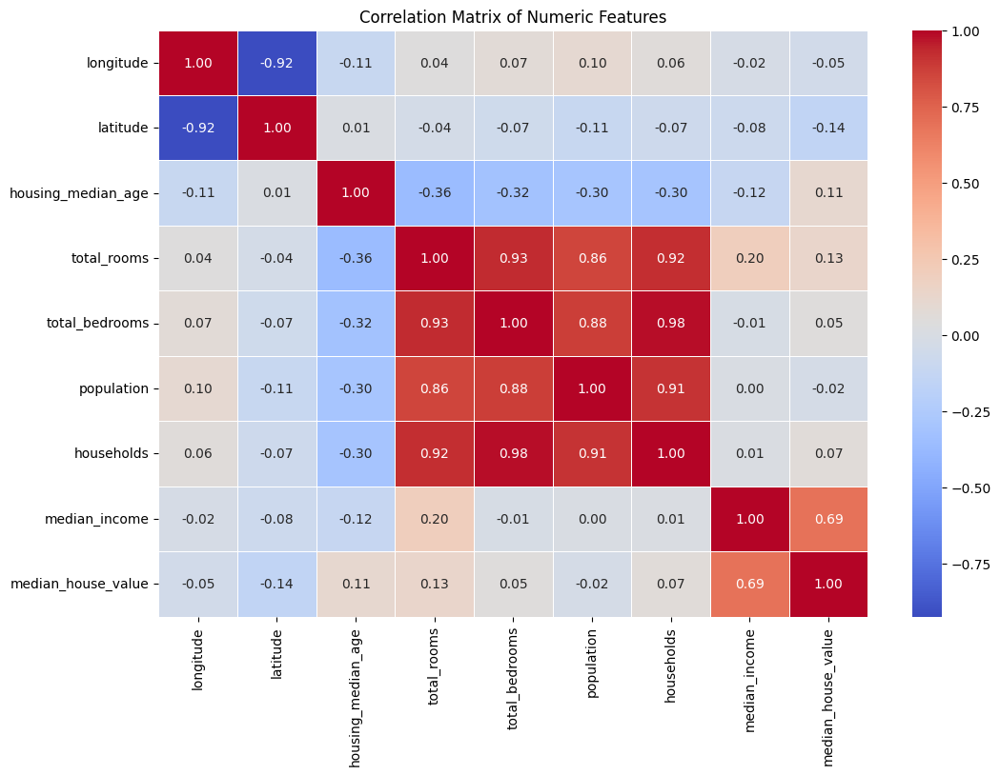

In [17]:
from data import EDA
import pandas as pd
# Perform EDA
data = pd.read_csv("housing.csv")
eda = EDA(data)
eda.display_basic_info()
eda.plot_lat_long(city_name="Houses in California")
eda.plot_correlation_matrix()

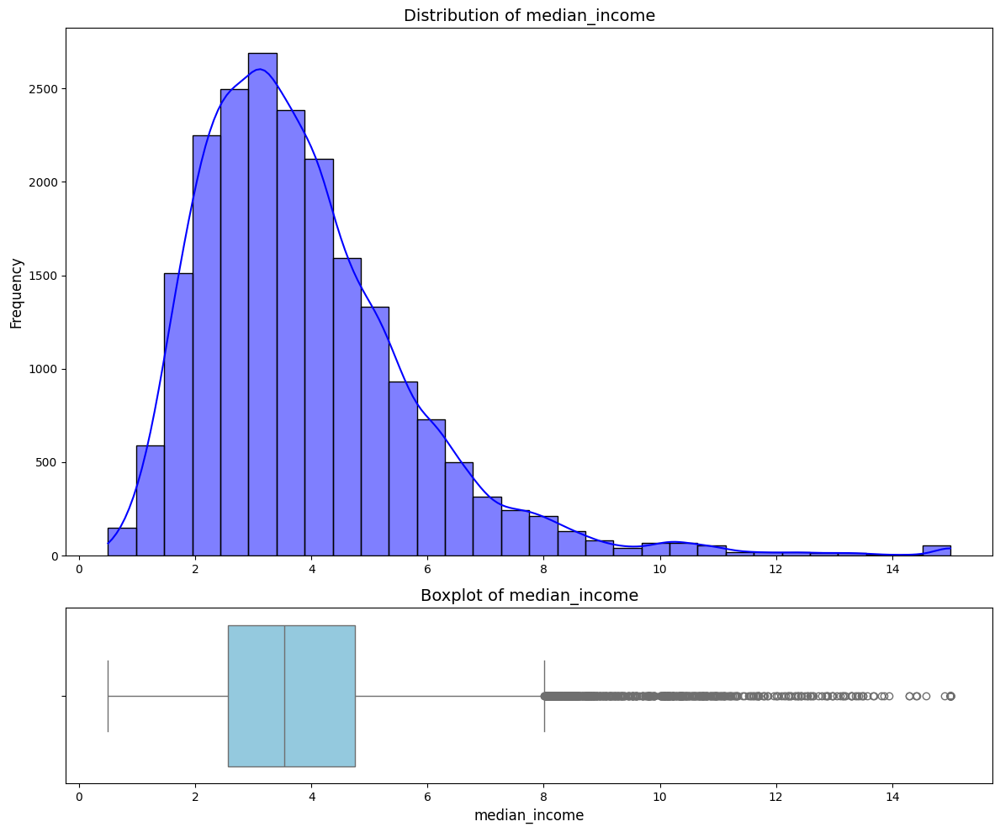

In [22]:
eda.compare_distribution_and_boxplot("median_income")

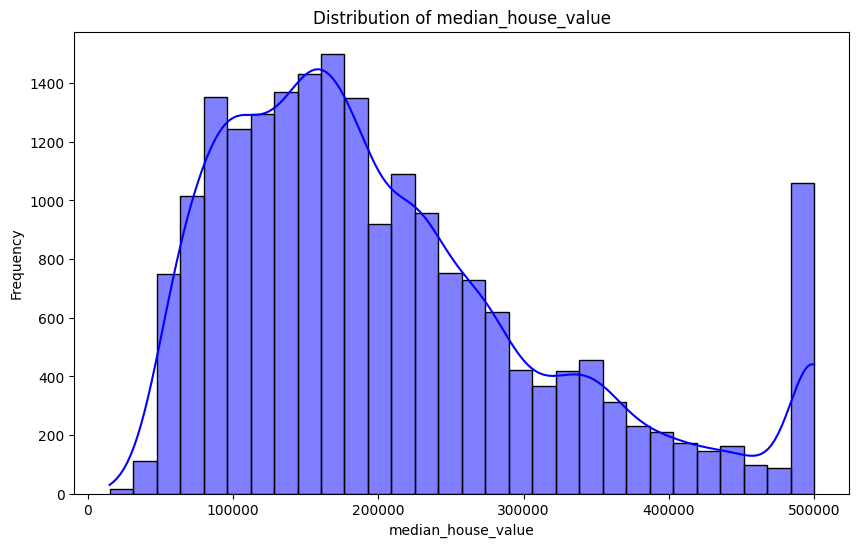

In [4]:
# Plot the distribution of a column
eda.plot_distribution("median_house_value")


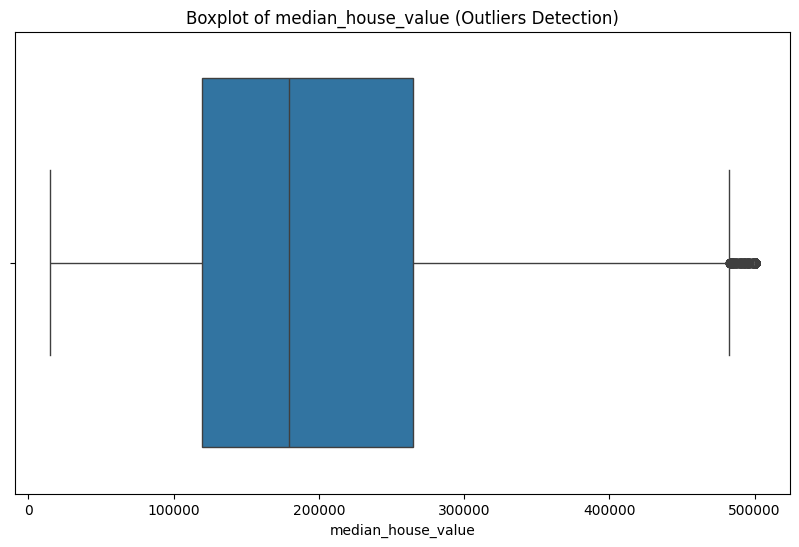

In [5]:
# Check for outliers in a specific column
eda.check_outliers("median_house_value")

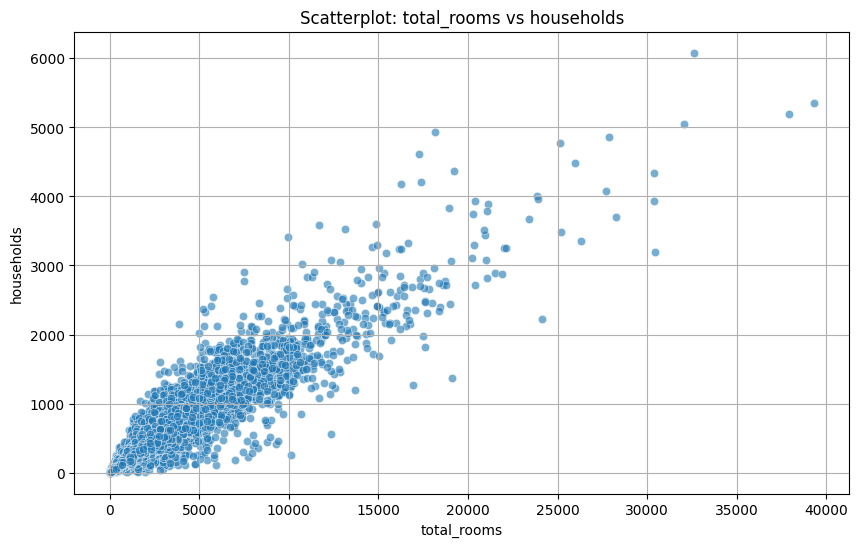

In [6]:
# Plot a scatterplot to visualize relationships
eda.plot_relationship("total_rooms", "households")

# Unsupervised Learning


## PCA

Non-numeric columns have been converted where possible.
Using Kaiser Rule: Retaining 3 components with eigenvalues > 1
Explained Variance Ratio (Selected Components): [0.43476625 0.21359172 0.18857021]
PCA Loadings:
     longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
PC1   0.076179 -0.075884           -0.216390     0.484432        0.489538   
PC2  -0.662017  0.690517            0.000910     0.060720        0.072145   
PC3  -0.247986  0.127760            0.049585     0.085001       -0.041180   

     population  households  median_income  median_house_value  
PC1    0.470143    0.491011       0.055842            0.045244  
PC2    0.046143    0.071802      -0.178306           -0.192222  
PC3   -0.077978   -0.026456       0.671092            0.673540  


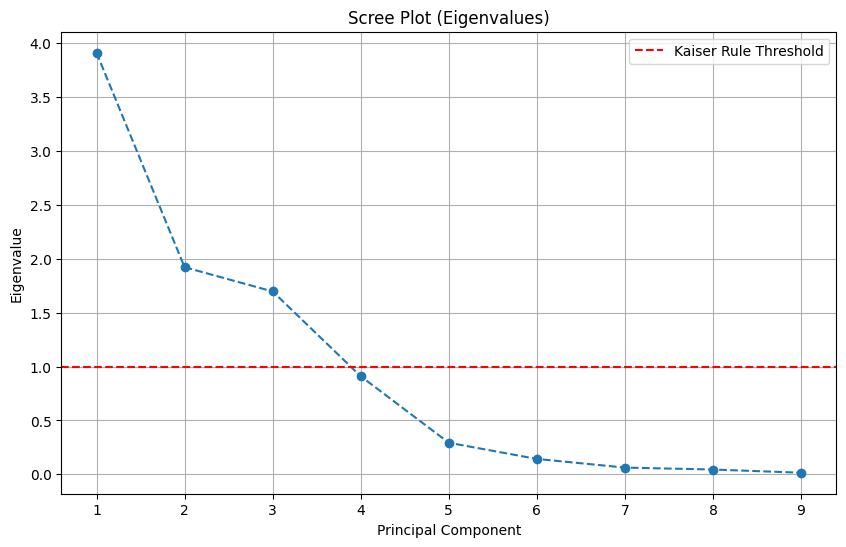

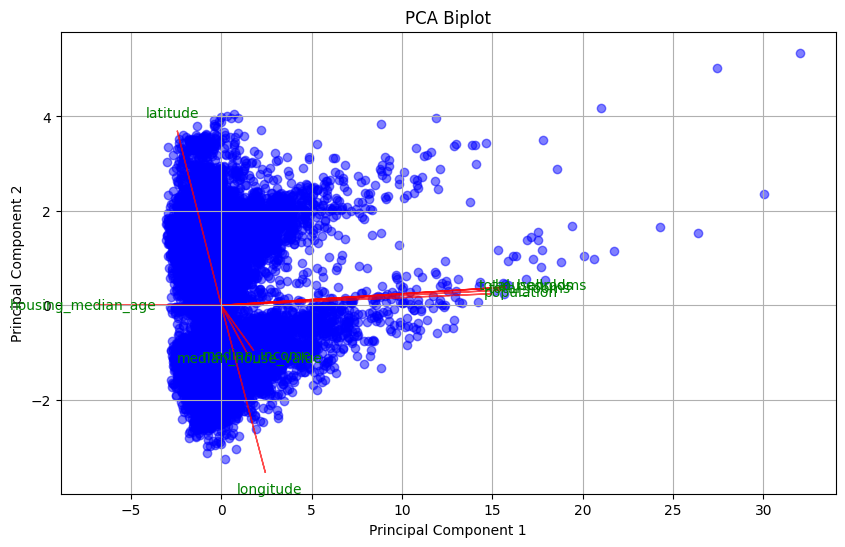

In [1]:
from unsupervized_analysis import UnsupervisedAnalysis
import pandas as pd

# Load dataset
data = pd.read_csv("processed_housing.csv")

# Initialize the analysis
analysis = UnsupervisedAnalysis(data)

# Perform PCA using the Kaiser Rule
pca_df, loadings = analysis.perform_pca()

# Inspect PCA loadings
print("PCA Loadings:")
print(loadings)

analysis.plot_screeplot()

analysis.plot_biplot()


# Clustering using KMeans

Explained Variance Ratio (Selected Components): [0.43476625 0.21359172 0.18857021]
Evaluating silhouette scores for different cluster numbers...
Number of clusters: 2, Silhouette score: 0.312
Number of clusters: 3, Silhouette score: 0.361
Number of clusters: 4, Silhouette score: 0.361
Number of clusters: 5, Silhouette score: 0.325
Number of clusters: 6, Silhouette score: 0.340
Number of clusters: 7, Silhouette score: 0.324
Number of clusters: 8, Silhouette score: 0.296
Number of clusters: 9, Silhouette score: 0.310
Number of clusters: 10, Silhouette score: 0.307


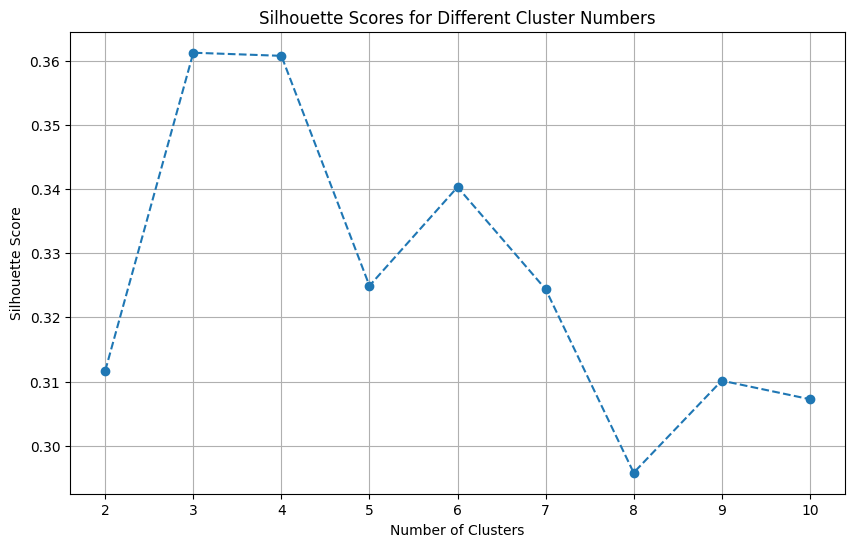

Optimal number of clusters based on silhouette score: 3
Cluster Centers:
[[-0.66454162  1.42409525  0.31170156]
 [ 4.85506749  0.28020153 -0.02890479]
 [-0.2522739  -1.12751848 -0.23269973]]
Silhouette Score: 0.361


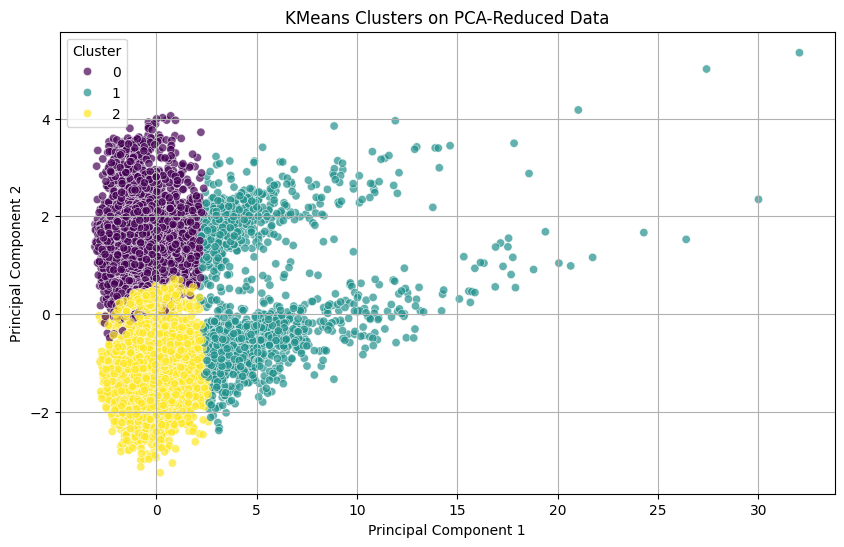

In [2]:
analysis.perform_pca(n_components=3)

optimal_clusters = analysis.optimize_kmeans_with_pca(max_clusters=10)
analysis.perform_kmeans_with_pca(n_clusters=optimal_clusters)

analysis.plot_pca_clusters()

analysis.plot_lat_long()

In [8]:
# Perform clustering on original data
kmeans_labels_original = analysis.perform_clustering(n_clusters=3, method="kmeans", use_pca=False)

# Compute silhouette score for original data
silhouette_original = analysis.compute_silhouette_score(use_pca=False)

# Plot clustering results for original data
analysis.plot_clusters(use_pca=False)

# Plot clustering results on a world map
analysis.plot_lat_long()

Cluster Centers (KMeans):
[[ 0.7813915  -0.80422658  0.08482824 -0.21321019 -0.19608276 -0.13748877
  -0.19074844  0.02016433  0.06661121]
 [-1.05383509  1.0790061   0.08366664 -0.20804128 -0.24432487 -0.28126536
  -0.24992686 -0.06561282 -0.11671598]
 [ 0.19658521 -0.17479745 -0.94801025  2.37175333  2.44058631  2.24937476
   2.43413607  0.19308826  0.14830663]]
Silhouette Score: -0.036
Please specify feature_x and feature_y for plotting.


Cluster Centers (KMeans):
[[ 0.12015587 -0.67976253 -0.54990222]
 [-0.16701623  1.13538096 -0.01581002]
 [ 0.02185358 -0.55605743  1.67080697]]
Silhouette Score: 0.312


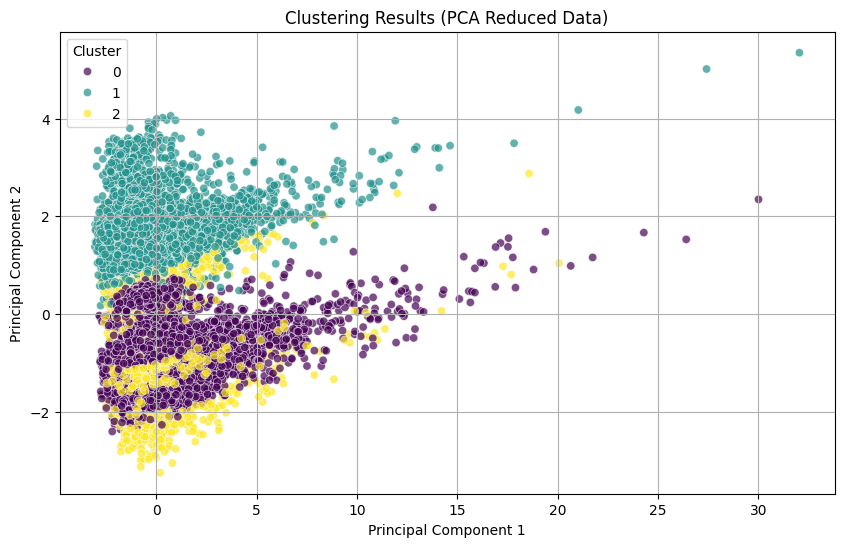

In [9]:
# Perform clustering on PCA-reduced data
kmeans_labels_pca = analysis.perform_clustering(n_clusters=3, method="kmeans", use_pca=True)

# Compute silhouette score for PCA-reduced data
silhouette_pca = analysis.compute_silhouette_score(use_pca=True)

# Plot clustering results for PCA-reduced data
analysis.plot_clusters(use_pca=True)

# Plot clustering results on a world map
analysis.plot_lat_long()

## Clustering using DBSCAN

In [10]:
# perform clustering using DBSCAN on original data
dbscan_labels_original = analysis.perform_clustering(
    method="dbscan",
    use_pca=False,
    eps=0.9,
    min_samples=10
)
# Compute silhouette score for original data
silhouette_original = analysis.compute_silhouette_score(use_pca=False)

# Plot clustering results for original data
analysis.plot_clusters(use_pca=False)

# Plot clustering results on a world map
analysis.plot_lat_long()

Number of clusters (DBSCAN): 3
Silhouette Score: -0.450
Please specify feature_x and feature_y for plotting.


Number of clusters (DBSCAN): 2
Silhouette Score: 0.266


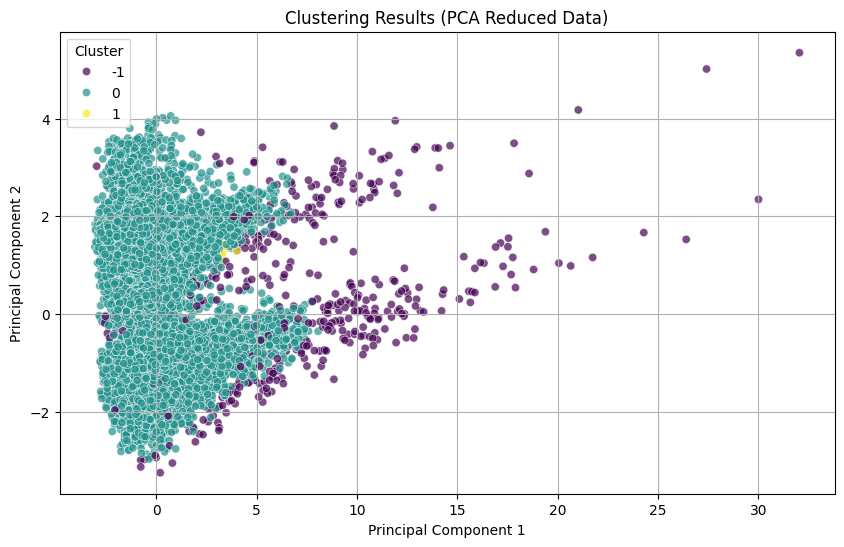

In [11]:
# perform clustering using DBSCAN on original data
dbscan_labels_original = analysis.perform_clustering(
    method="dbscan",
    use_pca=True,
    eps=0.5,
    min_samples=10,
    metric='manhattan'
)
# Compute silhouette score for original data
silhouette_original = analysis.compute_silhouette_score(use_pca=True)

# Plot clustering results for original data
analysis.plot_clusters(use_pca=True)

# Plot clustering results on a world map
analysis.plot_lat_long()

# Supervized analysis

Training Linear Regression...
Model: Linear Regression
Mean Absolute Error (MAE): 50413.4333
Mean Squared Error (MSE): 4802173538.6042
Root Mean Squared Error (RMSE): 69297.7167
R-squared (R²): 0.6488
Adjusted R-squared: 0.6478
--------------------------------------------------


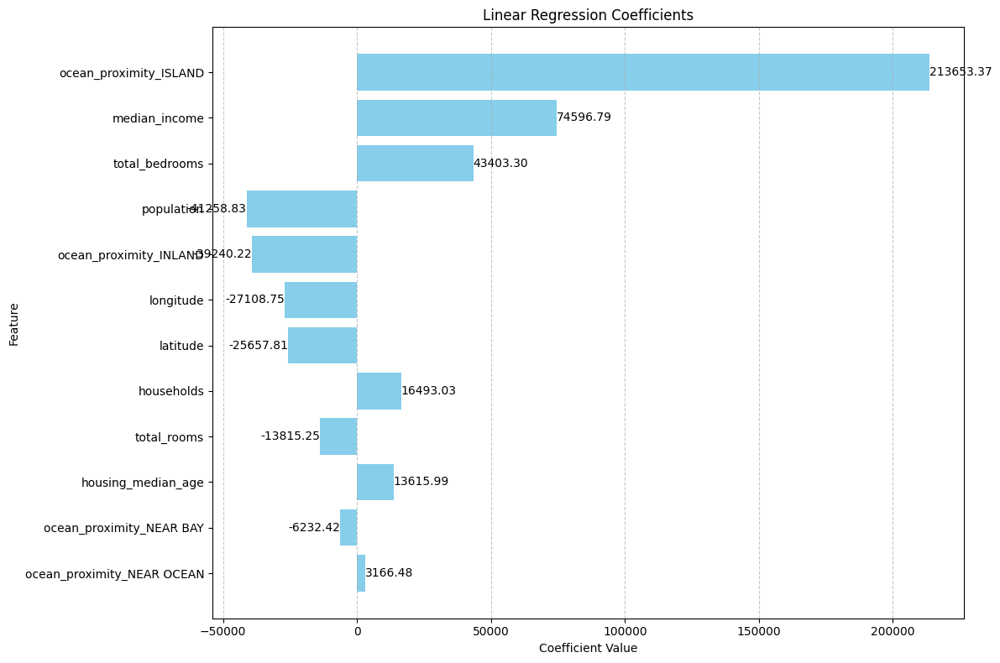


Training Random Forest...
Model: Random Forest
Mean Absolute Error (MAE): 31680.8255
Mean Squared Error (MSE): 2378846067.4186
Root Mean Squared Error (RMSE): 48773.4156
R-squared (R²): 0.8260
Adjusted R-squared: 0.8255
--------------------------------------------------


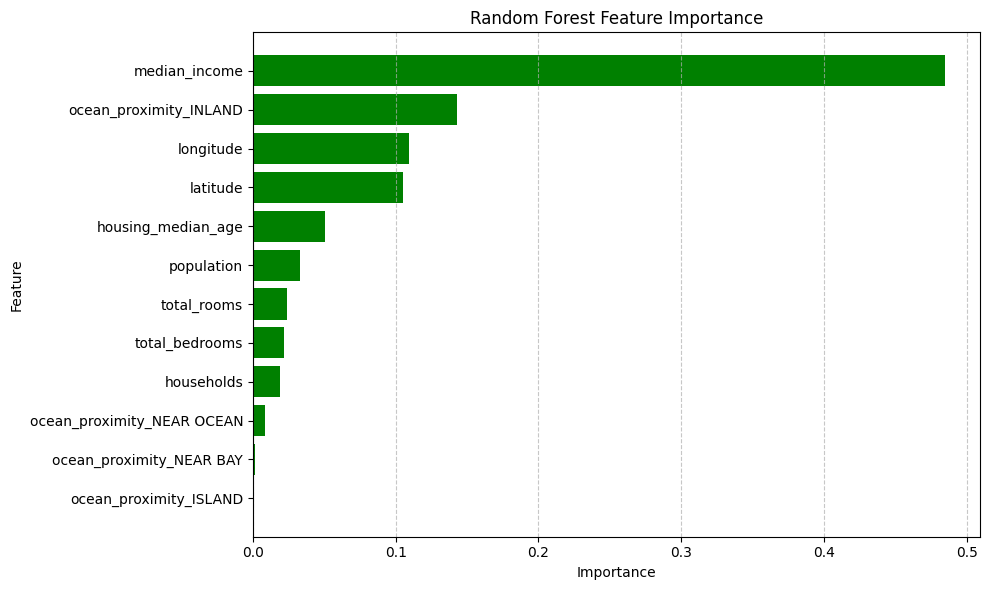


Training Neural Network...
Model: Neural Network
Mean Absolute Error (MAE): 45168.1077
Mean Squared Error (MSE): 4065283203.6488
Root Mean Squared Error (RMSE): 63759.5734
R-squared (R²): 0.7027
Adjusted R-squared: 0.7018
--------------------------------------------------

Training XGBoost...
Model: XGBoost
Mean Absolute Error (MAE): 38835.4862
Mean Squared Error (MSE): 3166036704.8747
Root Mean Squared Error (RMSE): 56267.5458
R-squared (R²): 0.7685
Adjusted R-squared: 0.7678
--------------------------------------------------


In [3]:
from supervized_analysis import SupervisedAnalysis
import pandas as pd

# Load dataset
data = pd.read_csv("processed_housing.csv")

# Initialize the analysis (replace 'median_house_value' with your target column)
analysis = SupervisedAnalysis(data, target_column='median_house_value')

# Run all models and evaluate them
analysis.run_all_models()
